#### This Notebook use Gemini and Imagen and helps to create a simple video from those images

#### Author: Saurabh Mangal (saurabhmangal@google.com)
##### Date: 21st Feb
##### Description: This notebook contains part 6 of lab

 Copyright (c) [2024] [saurabhmangal@] -- 
 This notebook is licensed under the Commercial License.

### Setup

In [49]:
!pip install --upgrade google-cloud-aiplatform -q
!sudo apt-get update 
!sudo apt-get install -y ffmpeg

Get:1 https://nvidia.github.io/libnvidia-container/stable/debian10/amd64  InRelease [1484 B]
Hit:2 https://deb.debian.org/debian bullseye InRelease                         
Hit:3 https://download.docker.com/linux/debian bullseye InRelease              
Hit:4 https://nvidia.github.io/nvidia-container-runtime/stable/debian10/amd64  InRelease
Hit:5 https://nvidia.github.io/nvidia-docker/debian10/amd64  InRelease         
Hit:6 https://packages.cloud.google.com/apt gcsfuse-bullseye InRelease         
Hit:7 https://packages.cloud.google.com/apt google-compute-engine-bullseye-stable InRelease
Hit:8 https://deb.debian.org/debian-security bullseye-security InRelease
Get:9 https://deb.debian.org/debian bullseye-updates InRelease [44.1 kB]
Hit:10 https://packages.cloud.google.com/apt cloud-sdk-bullseye InRelease  
Get:11 https://deb.debian.org/debian bullseye-backports InRelease [49.0 kB]    
Hit:12 https://packages.cloud.google.com/apt google-fast-socket InRelease   
Ign:13 https://packages.clo

In [4]:
# GCP_PROJECT= PROJECT_ID=project_id= !(gcloud config get-value core/project)
PROJECT_IDS= !(gcloud config get-value core/project)
PROJECT_ID = PROJECT_IDS[0]
GCP_PROJECT = PROJECT_ID
LOCATION = REGION = 'asia-southeast1'

print(GCP_PROJECT)
print(PROJECT_ID)


najihah-project
najihah-project


In [4]:
# Please use the same name as UNIQUE_PREFIX in the other notebooks
PREFIX = "INSERT NAME" 
GCS_BUCKET_LOCATION = "asia-southeast1"
GCS_BUCKET_NAME = f"{PROJECT_ID}-{PREFIX}"
GCS_BUCKET_URI = f"gs://{GCS_BUCKET_NAME}/videos"

# Create a Cloud Storage Bucket
!gcloud storage buckets create $GCS_BUCKET_URI --location=$GCS_BUCKET_LOCATION

# Upload the videos located in the videos/ directory into the GCS bucket that you created
!gsutil cp -r ./video/* $GCS_BUCKET_URI

# Verify that all Videos 1 to 5 are uploaded to the GCS bucket (5 files in total)
!gsutil ls $GCS_BUCKET_URI

Creating gs://najihah-project-INSERT/...
ERROR: (gcloud.storage.buckets.create) HTTPError 400: Invalid bucket name: 'najihah-project-INSERT'
CommandException: Destination URL must name a directory, bucket, or bucket
subdirectory for the multiple source form of the cp command.
CommandException: "ls" command does not support "file://" URLs. Did you mean to use a gs:// URL?


In [5]:
# Initialize Vertex AI
import vertexai

vertexai.init(project=PROJECT_ID, location=LOCATION)

In [6]:
from vertexai.preview.generative_models import (
    GenerationConfig,
    GenerativeModel,
    Image,
    Part,
)

In [7]:
multimodal_model = GenerativeModel("gemini-pro-vision")


### Define helper functions


In [8]:
import http.client
import typing
import urllib.request

import IPython.display
from PIL import Image as PIL_Image
from PIL import ImageOps as PIL_ImageOps


def display_images(
    images: typing.Iterable[Image],
    max_width: int = 600,
    max_height: int = 350,
) -> None:
    for image in images:
        pil_image = typing.cast(PIL_Image.Image, image._pil_image)
        if pil_image.mode != "RGB":
            # RGB is supported by all Jupyter environments (e.g. RGBA is not yet)
            pil_image = pil_image.convert("RGB")
        image_width, image_height = pil_image.size
        if max_width < image_width or max_height < image_height:
            # Resize to display a smaller notebook image
            pil_image = PIL_ImageOps.contain(pil_image, (max_width, max_height))
        IPython.display.display(pil_image)


def get_image_bytes_from_url(image_url: str) -> bytes:
    with urllib.request.urlopen(image_url) as response:
        response = typing.cast(http.client.HTTPResponse, response)
        image_bytes = response.read()
    return image_bytes


def load_image_from_url(image_url: str) -> Image:
    image_bytes = get_image_bytes_from_url(image_url)
    return Image.from_bytes(image_bytes)


def display_content_as_image(content: str | Image | Part) -> bool:
    if not isinstance(content, Image):
        return False
    display_images([content])
    return True


def display_content_as_video(content: str | Image | Part) -> bool:
    if not isinstance(content, Part):
        return False
    part = typing.cast(Part, content)
    file_path = part.file_data.file_uri.removeprefix("gs://")
    video_url = f"https://storage.googleapis.com/{file_path}"
    IPython.display.display(IPython.display.Video(video_url, width=600))
    return True


def print_multimodal_prompt(contents: list[str | Image | Part]):
    """
    Given contents that would be sent to Gemini,
    output the full multimodal prompt for ease of readability.
    """
    for content in contents:
        if display_content_as_image(content):
            continue
        if display_content_as_video(content):
            continue
        print(content)

### Generating a video description


Gemini 
### https://cloud.google.com/vertex-ai/pricing
$0.002 / second

For 60 seconds -video prices- 0.12$

In [9]:
prompt = """
What is shown in this video?
Where should I go to see it?
What are the top 5 places in the world that look like this?
"""
video = Part.from_uri(
    uri="gs://github-repo/img/gemini/multimodality_usecases_overview/mediterraneansea.mp4",
    mime_type="video/mp4",
)
contents = [prompt, video]

responses = multimodal_model.generate_content(contents, stream=True)

print("-------Prompt--------")
print_multimodal_prompt(contents)

print("\n-------Response--------")
for response in responses:
    print(response.text, end="")

-------Prompt--------

What is shown in this video?
Where should I go to see it?
What are the top 5 places in the world that look like this?




-------Response--------
 This is a video of the Mediterranean coast of Turkey. The video was taken from a drone and it shows the beautiful blue water, the rocky cliffs, and the whitewashed buildings of the town of Kas.

You can visit Kas by taking a flight to Dalaman Airport (DLM) and then taking a bus or taxi to Kas. The journey from the airport to Kas takes about an hour and a half.

The best time to visit Kas is from April to October when the weather is warm and sunny. The average temperature in Kas is 25 degrees Celsius (77 degrees Fahrenheit).

The top 5 places in the world that look like this are:

1. Santorini, Greece
2. Positano, Italy
3. Amalfi, Italy
4. Dubrovnik, Croatia
5. Cinque Terre, Italy

In [10]:
!gsutil ls $GCS_BUCKET_URI

CommandException: "ls" command does not support "file://" URLs. Did you mean to use a gs:// URL?


In [11]:
prompt = """
What is shown in this video?
Where should I go to see it?
What are the top 5 types of items that we see here?
"""

video_list = [f"gs://{GCS_BUCKET_NAME}/videos/butterflies_1280.mp4",
f"gs://{GCS_BUCKET_NAME}/videos/butterflies_960p.mp4",
f"gs://{GCS_BUCKET_NAME}/videos/elefant_1280p.mp4",
f"gs://{GCS_BUCKET_NAME}/videos/giraffes_1280p.mp4",
f"gs://{GCS_BUCKET_NAME}/videos/seafood_1280p.mp4"]

for i in range(0, len(video_list)) :
    print("\n\n\nHere is the video number",i, video_list[i])
    video = Part.from_uri( uri=video_list[i],
    mime_type="video/mp4",)
    contents = [prompt, video]
    
    responses = multimodal_model.generate_content(contents, stream=True)

    print("-------Prompt--------")
    print_multimodal_prompt(contents)

    print("\n-------Response--------")
    for response in responses:
        print(response.text, end="")




Here is the video number 0 gs://najihah-project-INSERT NAME/butterflies_1280.mp4
-------Prompt--------

What is shown in this video?
Where should I go to see it?
What are the top 5 types of items that we see here?




-------Response--------


InvalidArgument: 400 Request contains an invalid argument.

### Convert Images into Video

In [12]:
pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


In [25]:
import cv2
import os
import glob


### Default way

In [14]:
def create_video(image_folder, video_name, fps):
    images = [img for img in os.listdir(image_folder) if img.endswith(".jpg") or img.endswith(".png")]
    print(images)
    images.sort()  # Ensure images are in the correct order
    frame = cv2.imread(os.path.join(image_folder, images[0]))
    height, width, layers = frame.shape

    video = cv2.VideoWriter(video_name, 0, fps, (width, height))

    for image in images:
        video.write(cv2.imread(os.path.join(image_folder, image)))

    cv2.destroyAllWindows()
    video.release()
    


In [15]:
!pip install mediapy

In [16]:
import mediapy as media

In [17]:
# Example usage:
image_folder = './images/'
video_name = 'my_video.avi'
fps = 2  # Frames per second
width = 640  # Video width
height = 480  # Video height
create_video(image_folder, video_name, fps)

['google_workspace.png', '01_CH-ZRH-EURH-Copy1.png', '01_CH-ZRH-EURH-02.png', '01_CH-ZRH-EURH-02-Copy1.png', '01_CH-ZRH-EURH.png']


In [18]:
# Get a list of image files in the directory
image_files = glob.glob(os.path.join(image_folder, "*.png"))

# Sort the image files in ascending order
image_files.sort(key=os.path.getmtime)

# Resize all images to the same size
resized_images = []
for image_file in image_files:
    image = cv2.imread(image_file)
    resized_image = cv2.resize(image, (width, height))
    resized_images.append(resized_image)

In [19]:
# Create a video writer object
size = (width, height)
video_name = 'my_video.avi' 

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_writer = cv2.VideoWriter(video_name, fourcc, fps, size)

# Write the images to the video
for image in resized_images:
    video_writer.write(image)

# Release the video writer object
video_writer.release()

In [20]:
# from IPython.display import Video

# Video('my_video.avi') 

video = media.read_video('my_video.avi')
media.show_video(video, title = "Images to video", fps=2, width=500)

### Resize and create video

In [21]:
!pip install mediapy

In [22]:
import mediapy as media

In [23]:
# Set the desired video properties
fps = 1  # Frames per second
width = 640  # Video width
height = 480  # Video height
image_folder = './images/tiger-512/'

# Get a list of image files in the directory
image_files = glob.glob(os.path.join(image_folder, "*.png"))

# Sort the image files in ascending order
image_files.sort(key=os.path.getmtime)

# Resize all images to the same size
resized_images = []
for image_file in image_files:
    image = cv2.imread(image_file)
    resized_image = cv2.resize(image, (width, height))
    resized_images.append(resized_image)

libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile


In [24]:
print(image_files)

['./images/tiger-512/00000000_512resized.png', './images/tiger-512/00000004_512resized.png', './images/tiger-512/00000002_512resized.png', './images/tiger-512/00000003_512resized.png', './images/tiger-512/00000005_512resized.png', './images/tiger-512/00000009_512resized.png', './images/tiger-512/00000007_512resized.png', './images/tiger-512/00000010_512resized.png', './images/tiger-512/00000011_512resized.png', './images/tiger-512/00000016_512resized.png', './images/tiger-512/00000013_512resized.png', './images/tiger-512/00000015_512resized.png', './images/tiger-512/00000018_512resized.png', './images/tiger-512/00000017_512resized.png', './images/tiger-512/00000020_512resized.png', './images/tiger-512/00000021_512resized.png', './images/tiger-512/00000019_512resized.png', './images/tiger-512/00000022_512resized.png', './images/tiger-512/00000023_512resized.png', './images/tiger-512/00000025_512resized.png', './images/tiger-512/00000027_512resized.png', './images/tiger-512/00000024_512r

In [25]:
# Create a video writer object
size = (640, 480)
video_name = 'my_tiger.avi' 

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_writer = cv2.VideoWriter(video_name, fourcc, fps, size)

# Write the images to the video
for image in resized_images:
    video_writer.write(image)

# Release the video writer object
video_writer.release()

#from IPython.display import Video

#Video(video_name) 

video = media.read_video(video_name)
media.show_video(video, title = "Hello Tiger", fps=10, width=600)

### lets use Imagen and modify one image for few things and create a few copies of that to really create a movie

In [26]:
# from vertexai.preview.vision_models import ImageGenerationModel

In [9]:
import os
import vertexai
from vertexai.preview.language_models import TextGenerationModel
from vertexai.preview.generative_models import GenerativeModel, Part
Region = f"{LOCATION}"
GCP_PROJECT= PROJECT_ID=project_id= f"{GCP_PROJECT}"

vertexai.init()

def generate_pro(input_prompt):
    model = GenerativeModel("gemini-pro")
    responses = model.generate_content(
    input_prompt,
    generation_config={
        "max_output_tokens": 2048,
        "temperature": 0.2,
        "top_p": 1
    },stream=True,)
    
    all_response  = []
    
    for response in responses:
        all_response.append(response.text)
    
    # print (all_response)
    
    return(" ".join(all_response))

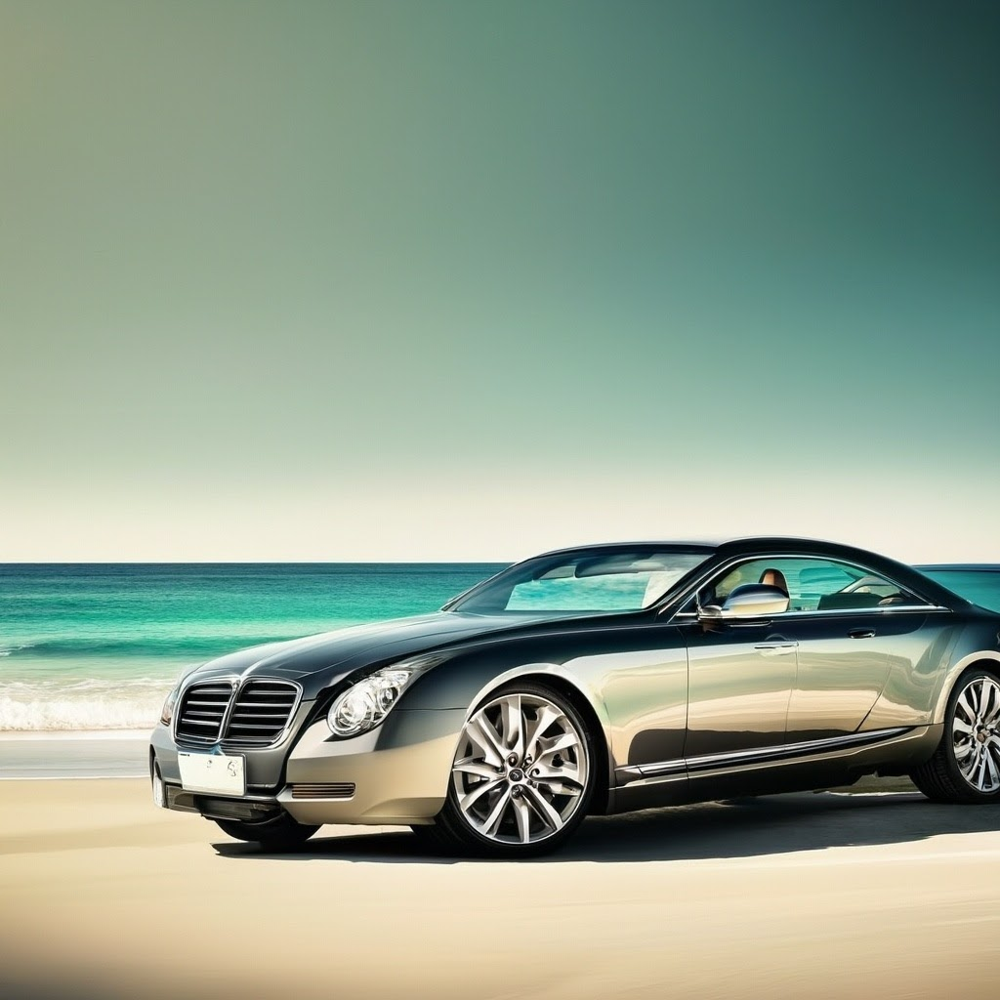

In [16]:
Google_Imagen_model = "imagegeneration@002" #"imagegeneration@005"
from vertexai.preview.vision_models import Image, ImageGenerationModel

imagen_model = ImageGenerationModel.from_pretrained(Google_Imagen_model)

input_question = "Create a picture of a luxury car at a distance on a beach "
system_prompt = " Convert this question to a meaning prompt for imagen model to create a good image - in photography style"

prompt = input_question + " " + system_prompt
image_prompt = generate_pro(prompt)

response = imagen_model.generate_images(
    prompt=image_prompt,
)

response.images[0].show()
response.images[0].save(location="./images/tiger-modified/gen-imagen.png")

del(imagen_model )

### Image editing

In [17]:
response.images[0].save(location="./images/tiger-modified/gen-imagen.png")

location_img = "./images/tiger-modified/gen-imagen.png"
base_img=Image.load_from_file(location=location_img)


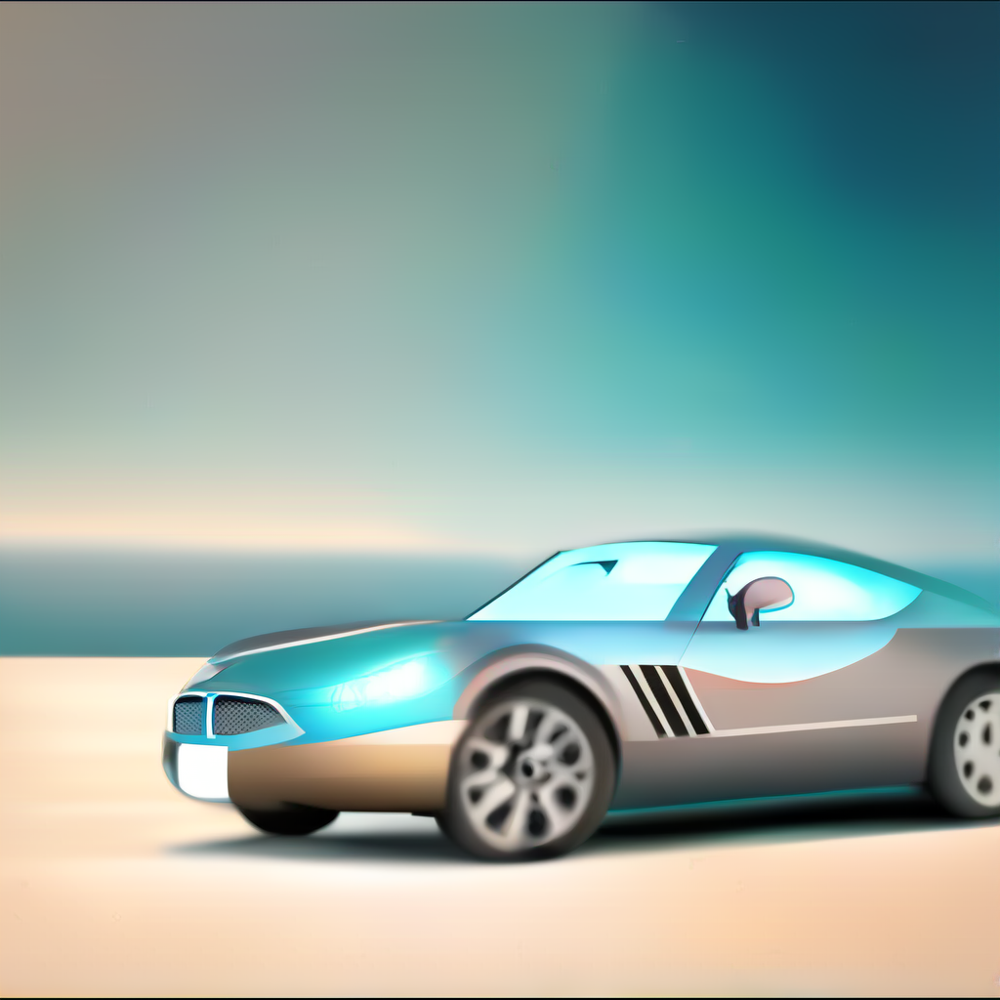

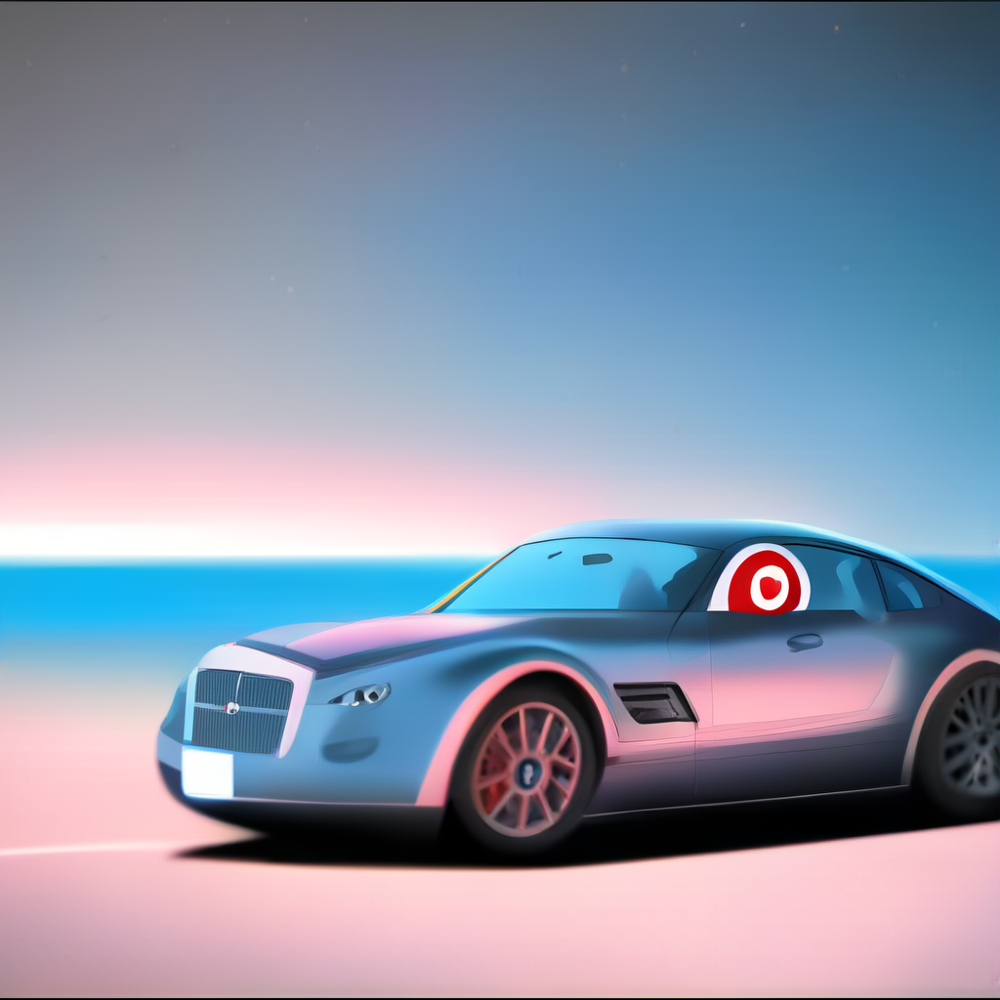

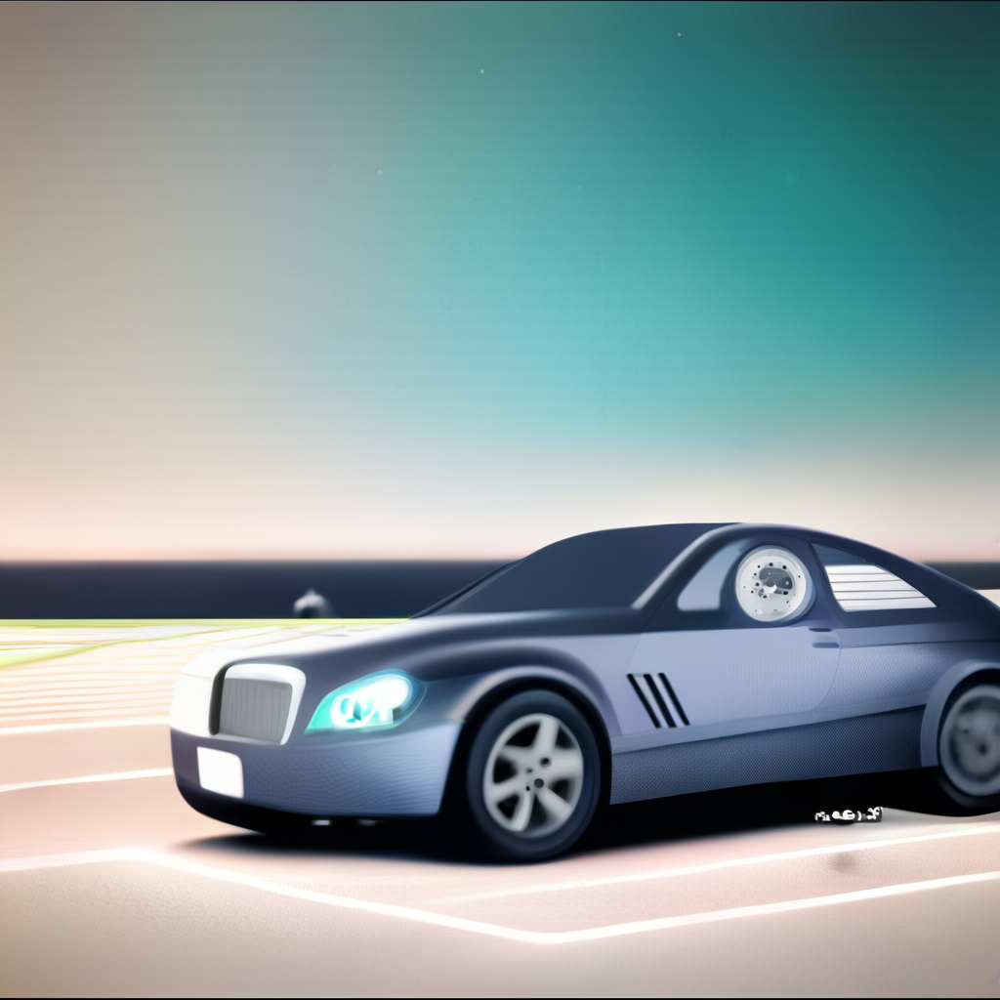

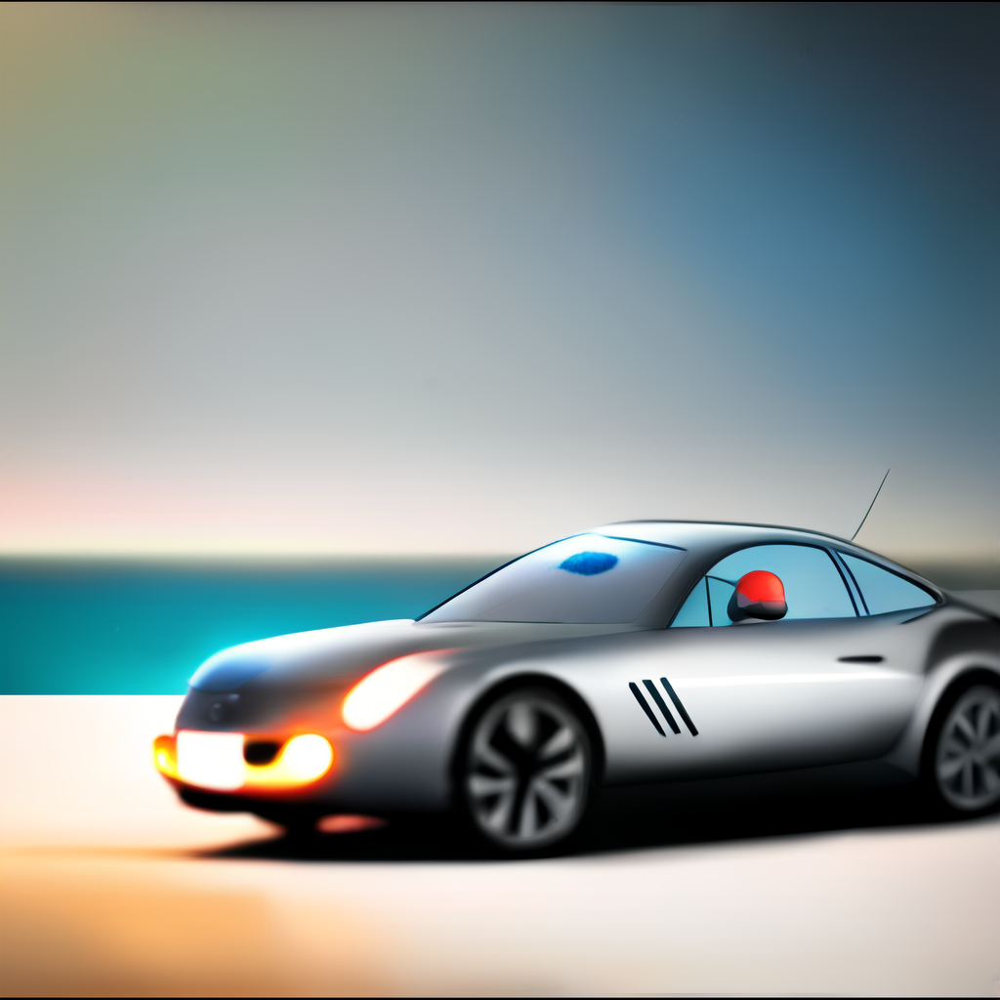

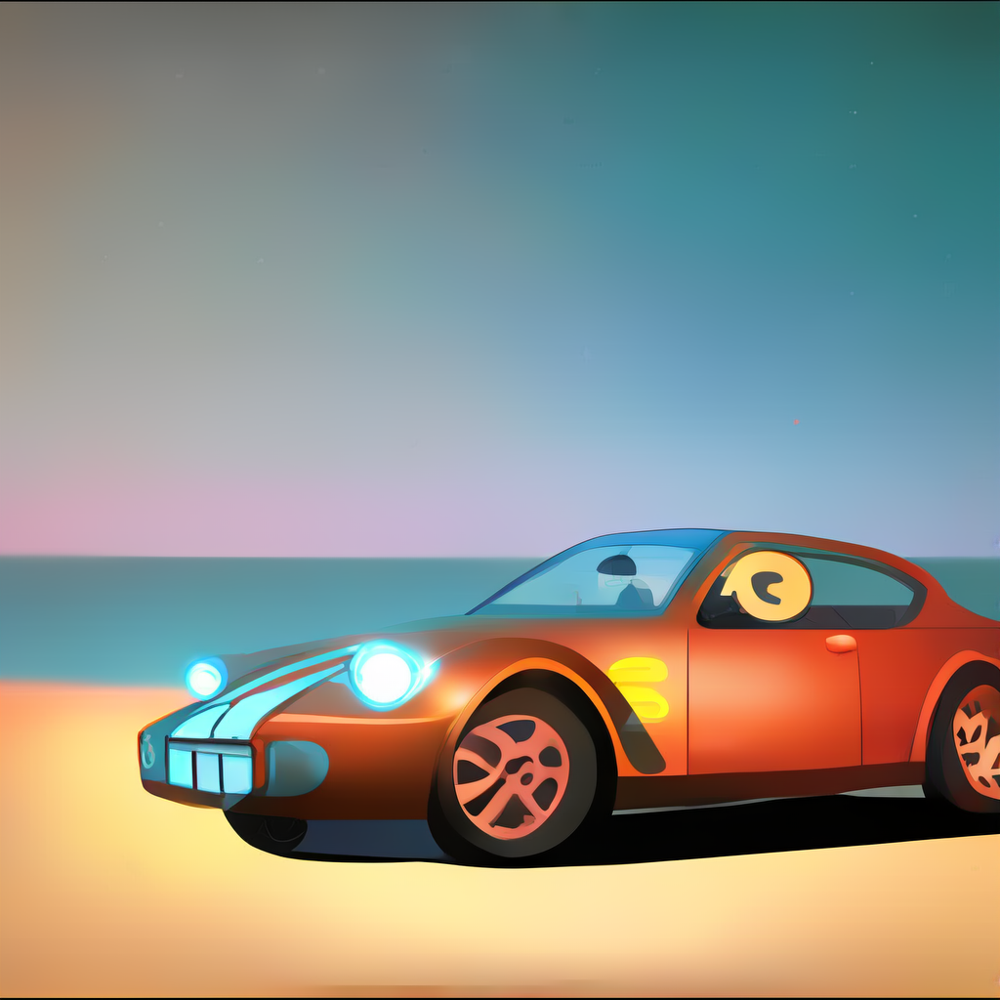

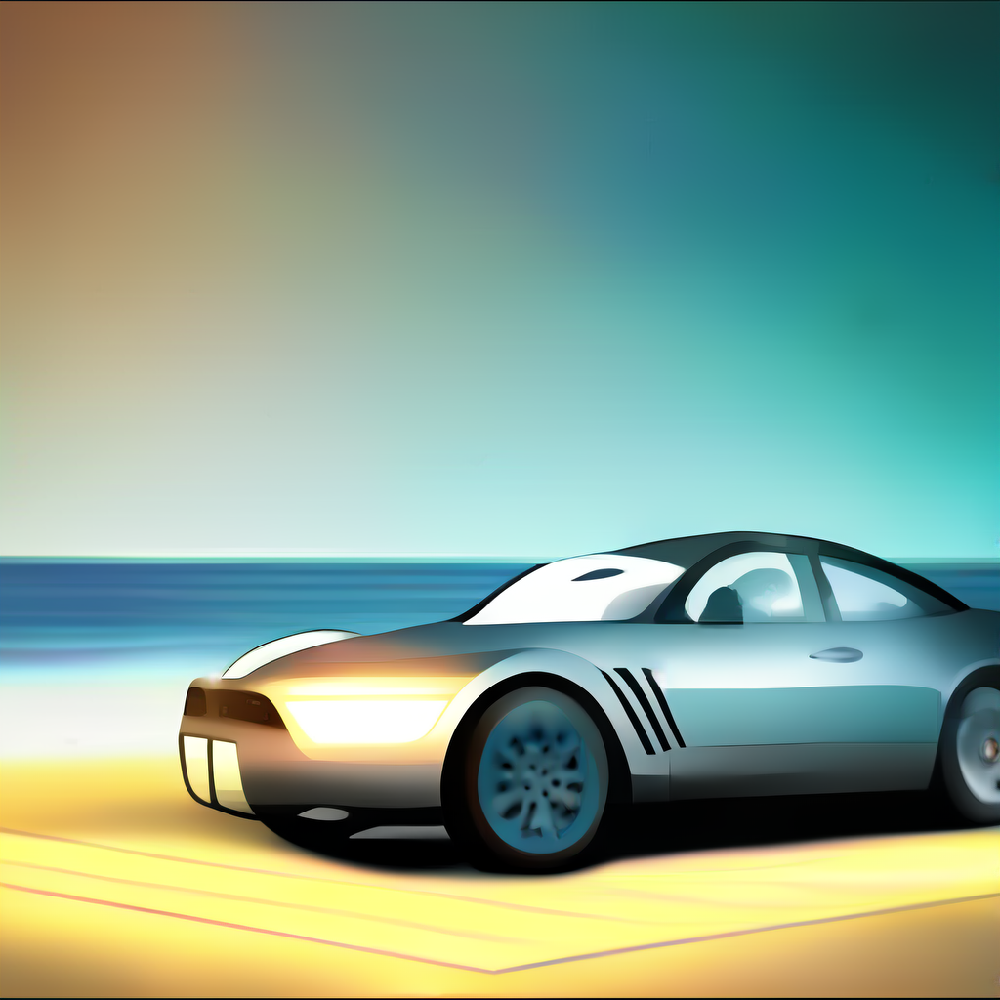

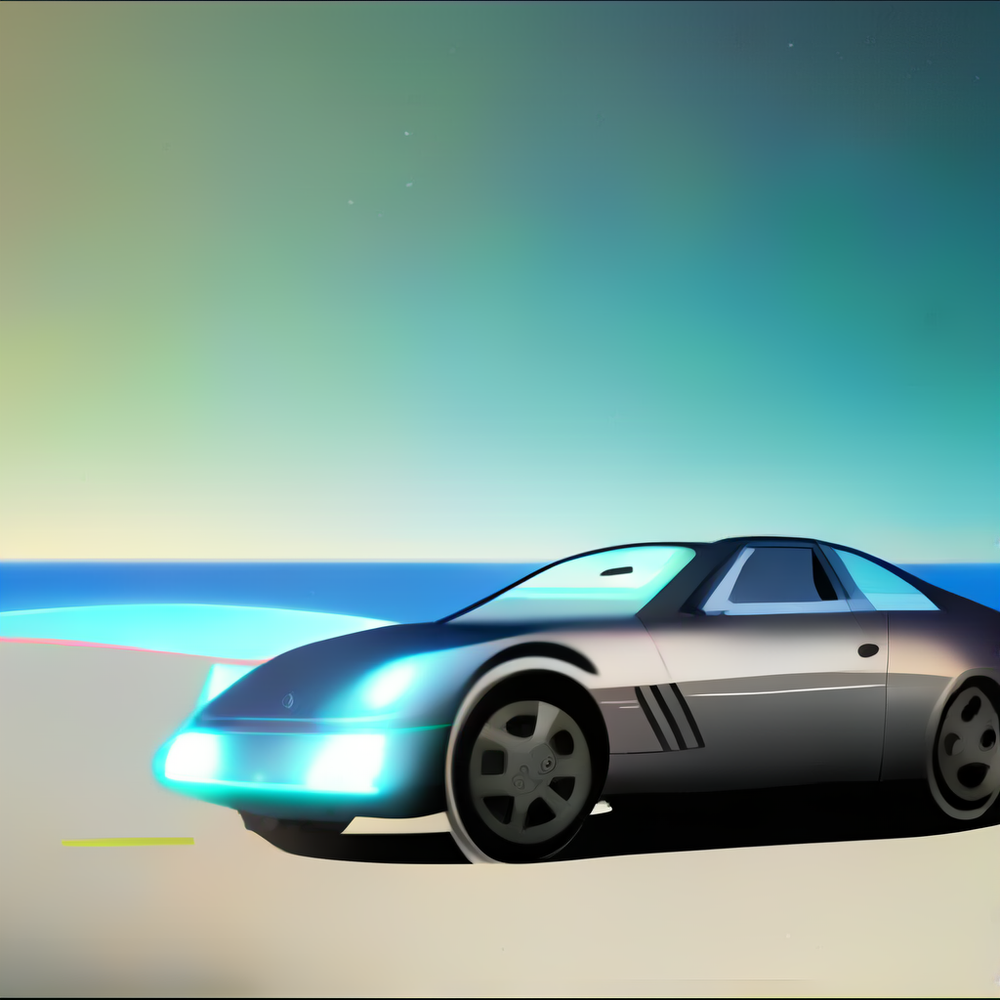

In [48]:
model = ImageGenerationModel.from_pretrained(Google_Imagen_model)

images = model.edit_image(
  base_image=base_img,
  prompt="create an animated story where the base image car is driving from Point A to Point B from day to night",
  # negativePrompt = "red colour",
  # Optional:
  seed=10,
  guidance_scale=20,
  number_of_images=8
)

for i, image in enumerate(images):
    filename = f"edit-fire-img{i+1}.png"  # Include index in filename
    image.save(f"./images/tiger-modified/{filename}")

# Optional. View the edited images in a notebook.
# Use a loop for cleaner code
for image in images:
    image.show()

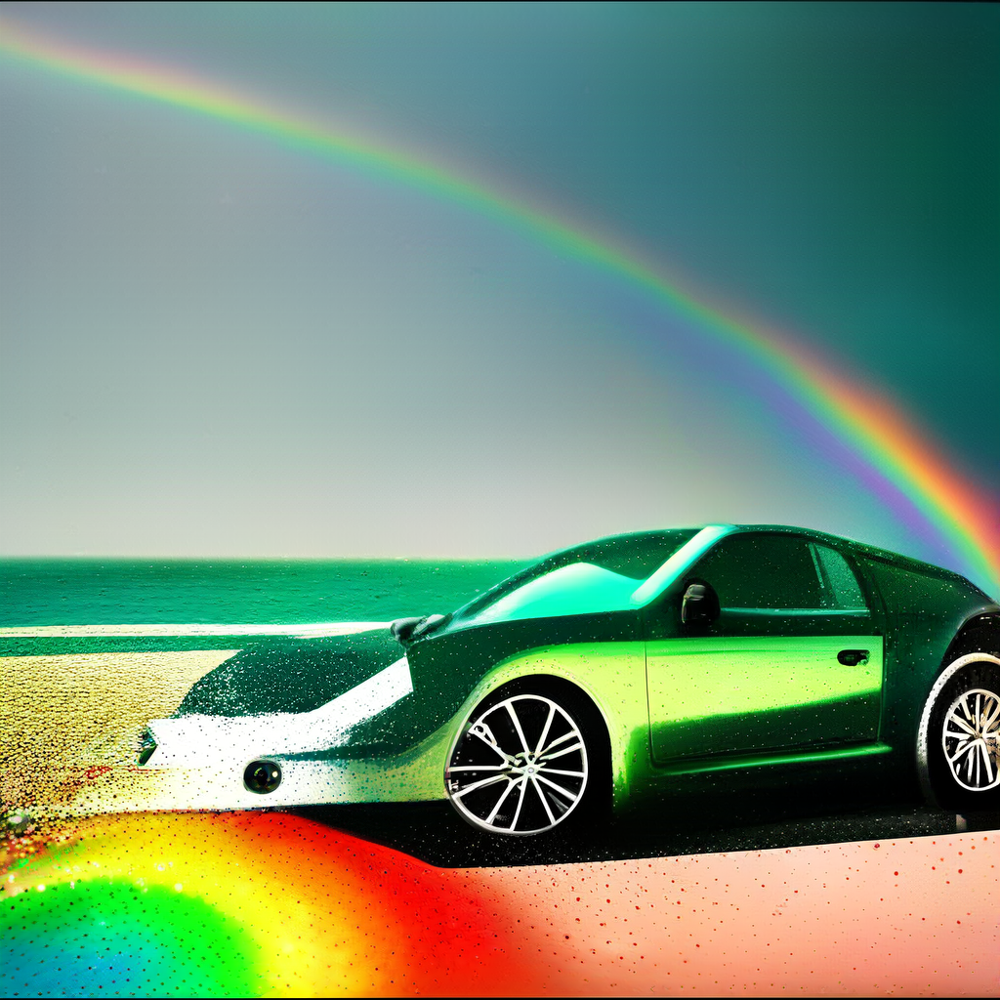

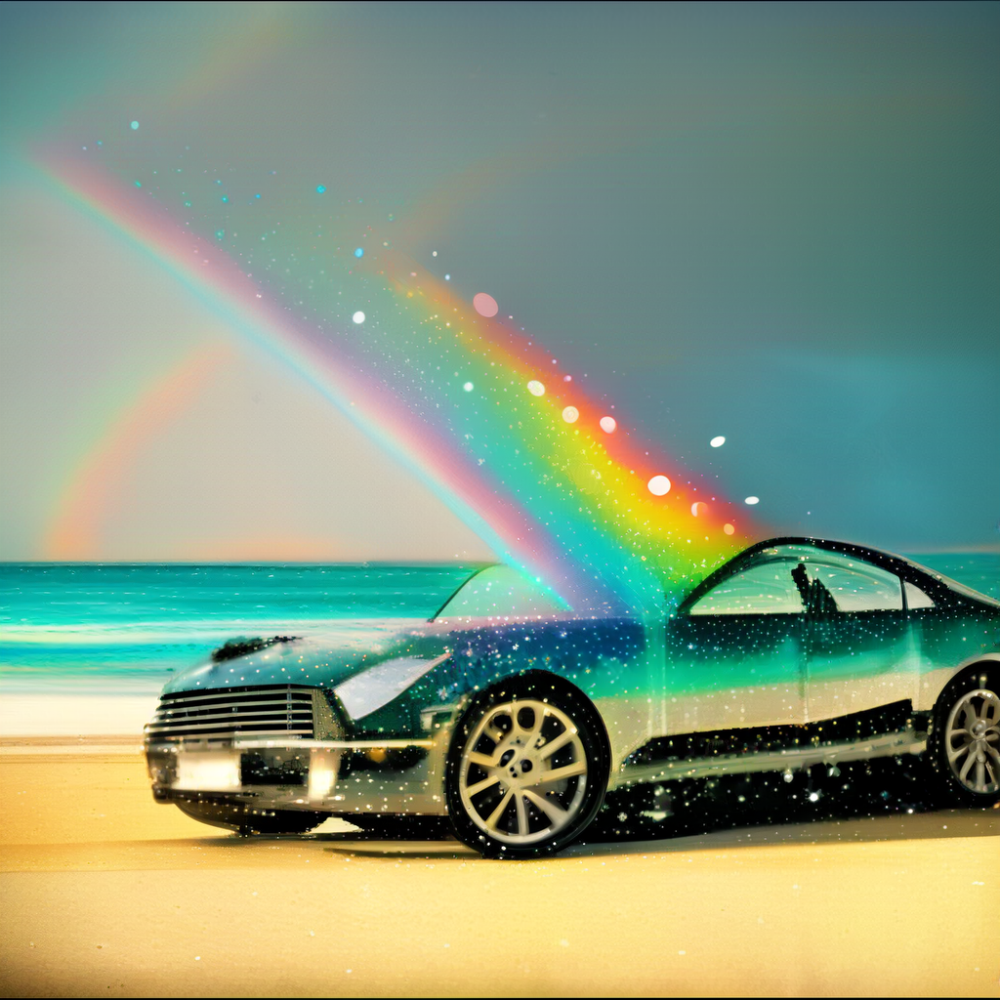

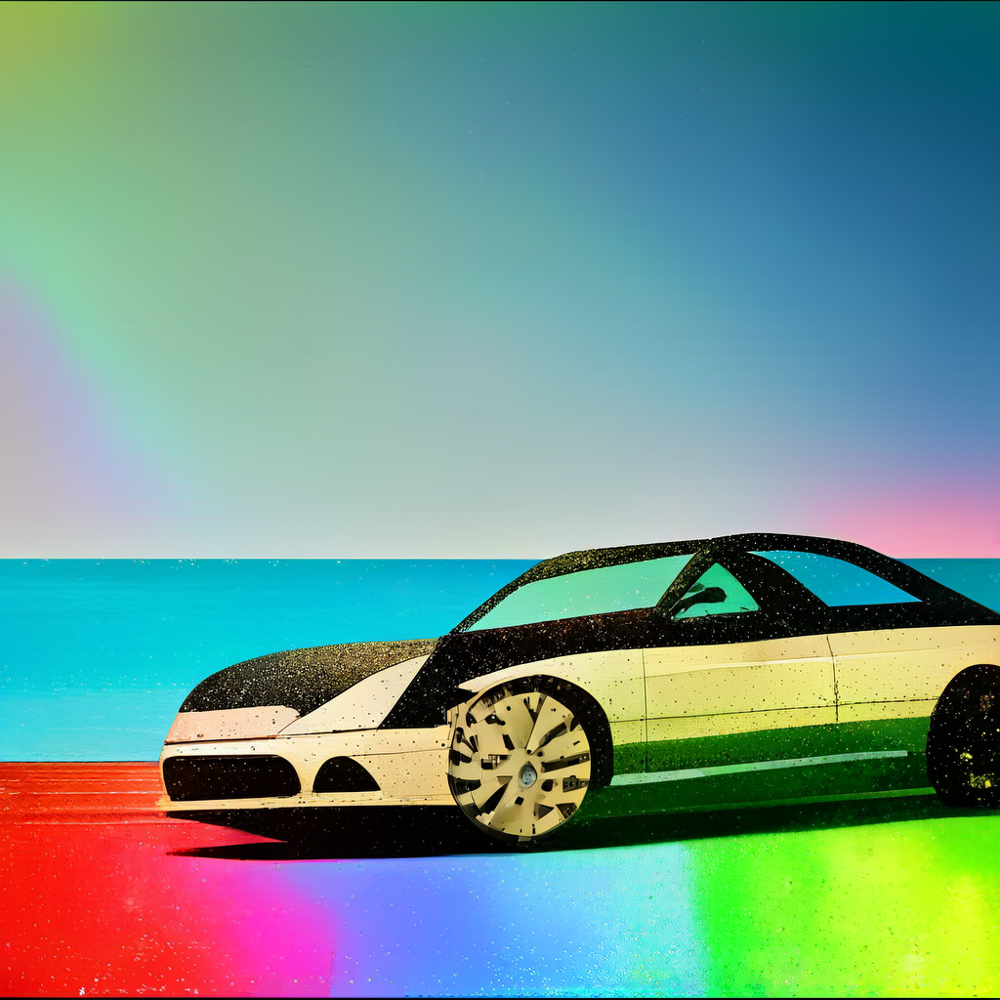

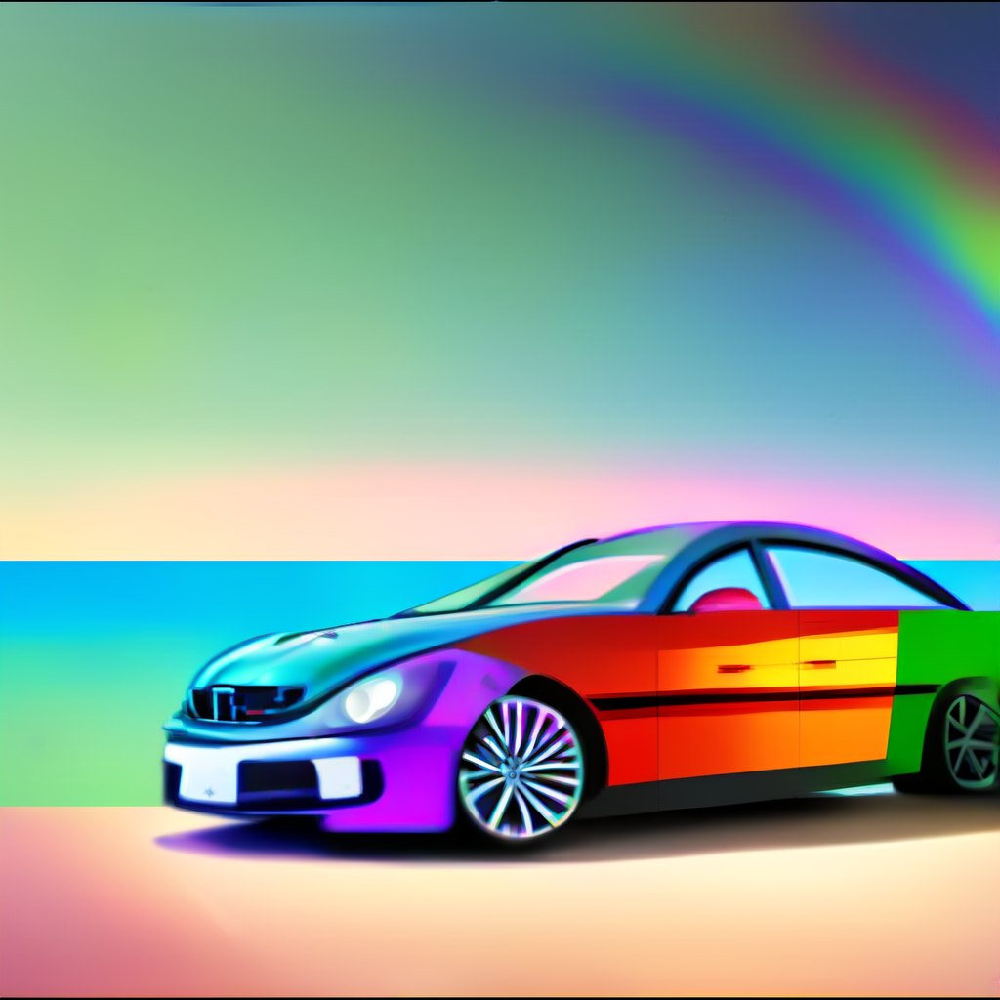

In [20]:

images = model.edit_image(
  base_image=base_img,
  prompt="add rainbow to the background",
  # negativePrompt = "red colour",
  # Optional:
  seed=0,
  guidance_scale=21,
  number_of_images=4
)

for i, image in enumerate(images):
    filename = f"edit-rainbow-img{i+1}.png"  # Include index in filename
    image.save(f"./images/tiger-modified/{filename}")

# Optional. View the edited images in a notebook.
# Use a loop for cleaner code
for image in images:
    image.show()

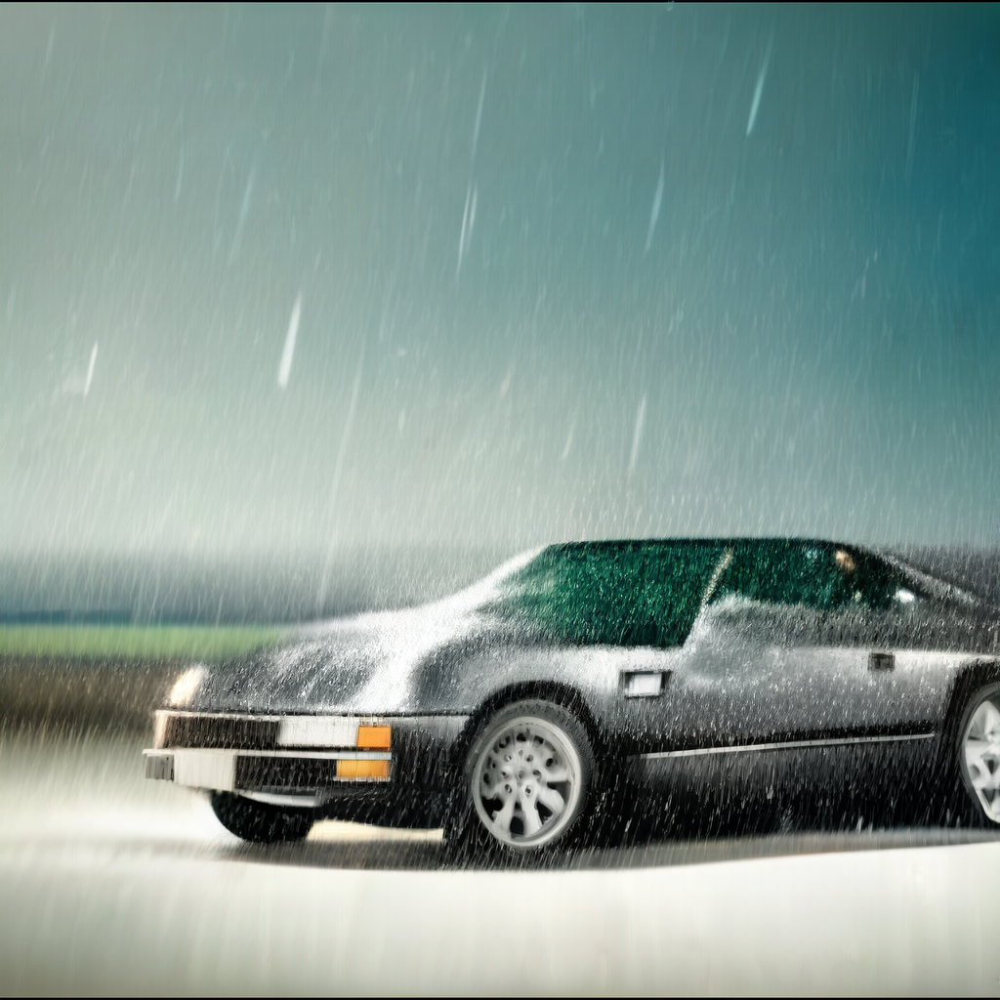

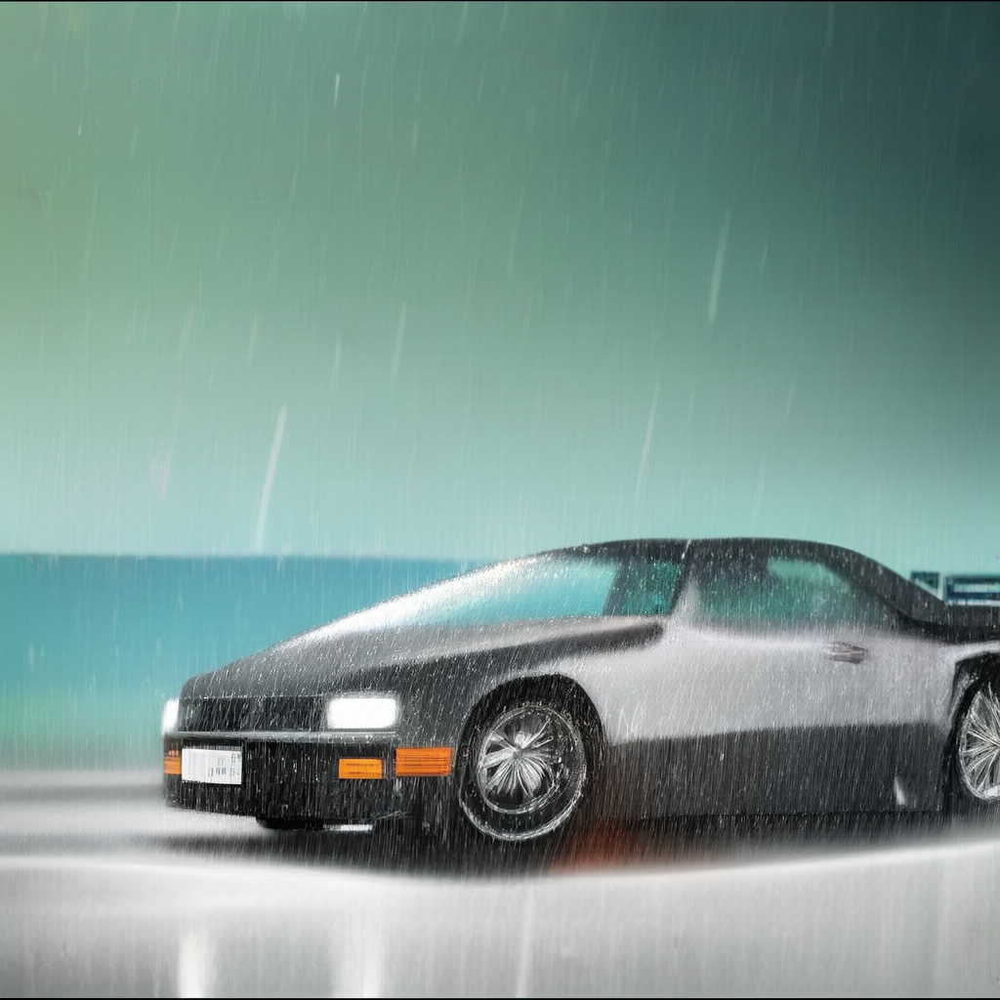

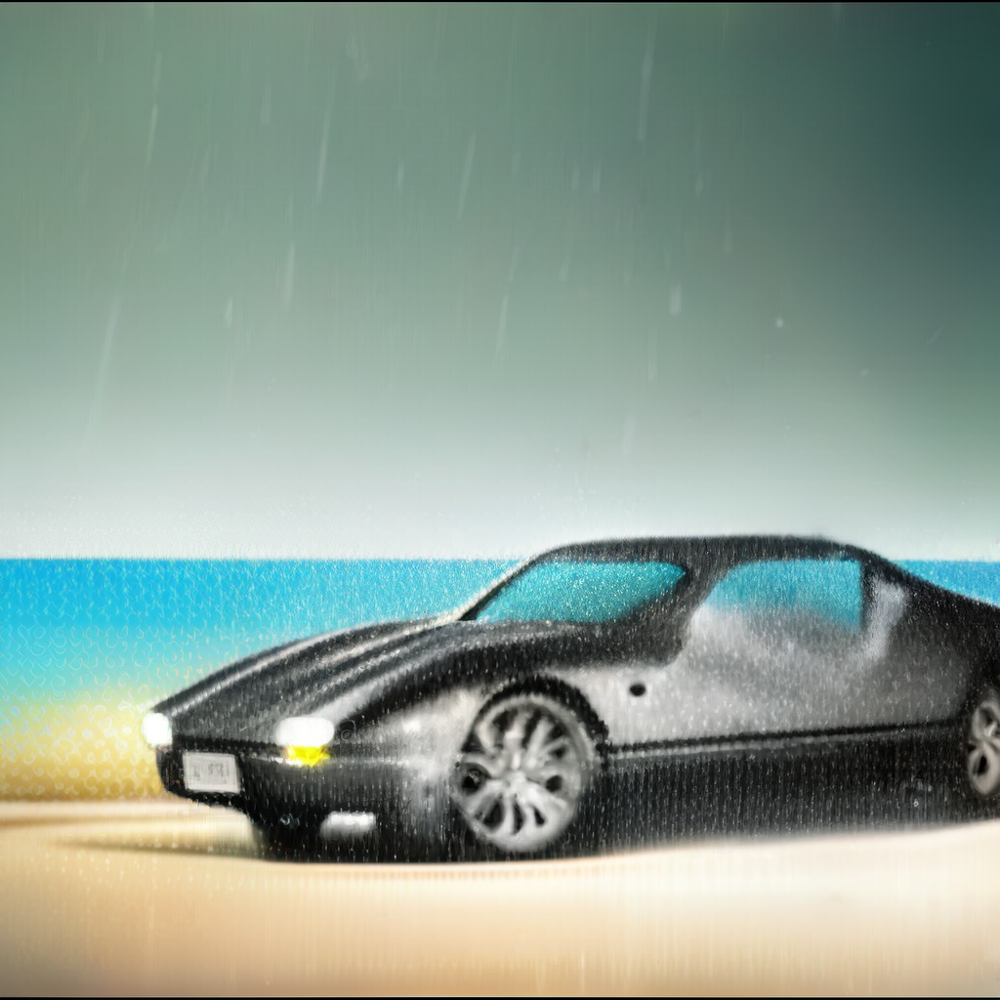

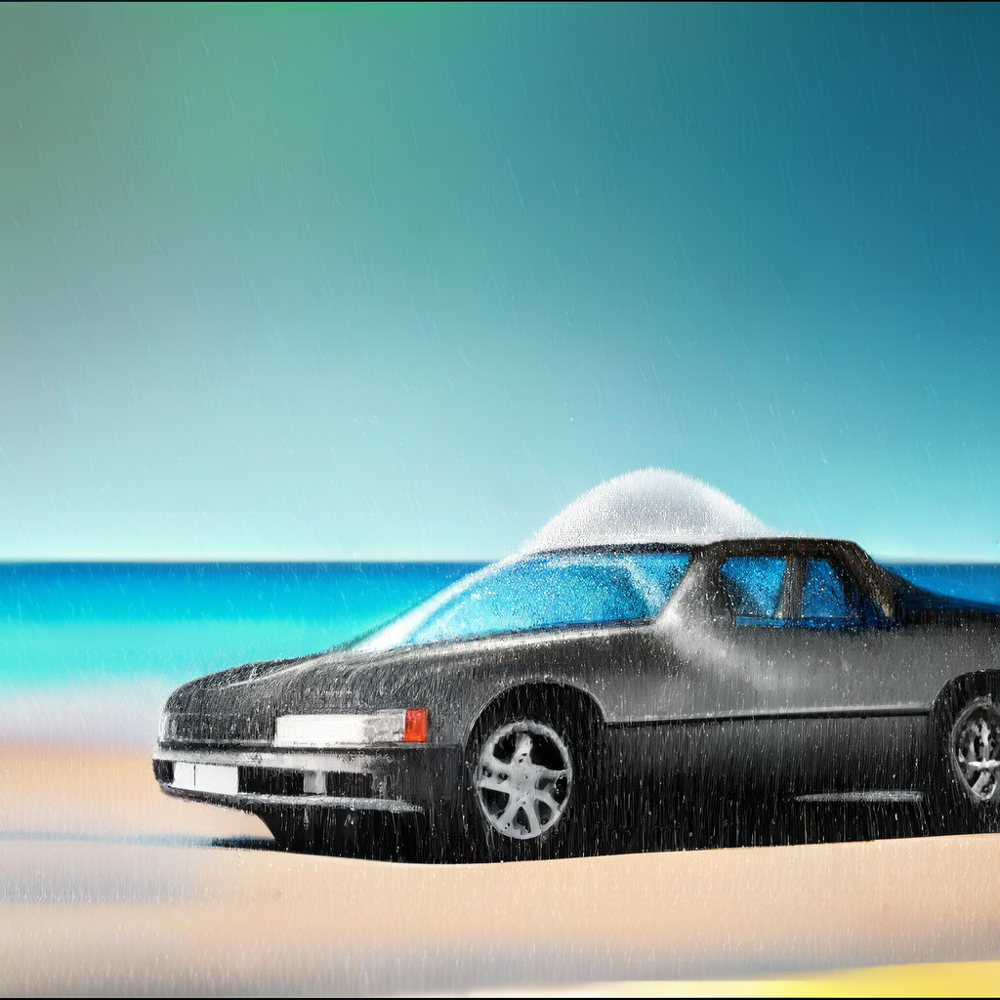

In [21]:

images = model.edit_image(
  base_image=base_img,
  prompt="add rain",
  # negativePrompt = "red colour",
  # Optional:
  seed=12,
  guidance_scale=21,
  number_of_images=4
)

for i, image in enumerate(images):
    filename = f"edit-clouds-img{i+1}.png"  # Include index in filename
    image.save(f"./images/tiger-modified/{filename}")

# Optional. View the edited images in a notebook.
# Use a loop for cleaner code
for image in images:
    image.show()

### Convert Images to Videos

In [22]:
!pip install mediapy

In [23]:
import mediapy as media

In [40]:
# Set the desired video properties
fps = 1  # Frames per second
width = 800  # Video width
height = 580  # Video height
image_folder = './images/tiger-modified/'

# Get a list of image files in the directory
image_files = glob.glob(os.path.join(image_folder, "*.png"))

# Sort the image files in ascending order
image_files.sort(key=os.path.getmtime)

# Resize all images to the same size
resized_images = []
for image_file in image_files:
    image = cv2.imread(image_file)
    resized_image = cv2.resize(image, (width, height))
    resized_images.append(resized_image)

In [41]:
# Create a video writer object
size = (width, height)
video_name = 'my_video_harry.mp4' 

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_writer = cv2.VideoWriter(video_name, fourcc, fps, size)

# Write the images to the video
for image in resized_images:
    video_writer.write(image)

# Release the video writer object
video_writer.release()



In [42]:
# from IPython.display import Video

# Video(video_name) 

video = media.read_video(video_name)
media.show_video(video, title = "video without audio", fps=5, width=500)

In [43]:
!rm -rf my_video_harry_music_v1.mp4
!ffmpeg -i my_video_harry.mp4 -i chkpt.mp3 -c:v copy -c:a aac my_video_harry_music_v1.mp4

ffmpeg version 4.3.6-0+deb11u1 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 10 (Debian 10.2.1-6)
  configuration: --prefix=/usr --extra-version=0+deb11u1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab 

In [44]:
video_name_with_music = "my_video_harry_music_v1.mp4"
video = media.read_video('my_video_harry_music_v1.mp4')
media.show_video(video, title = "HP", fps=1, width=500)

from IPython.display import Video
video_name_with_music = "my_video_harry_music_v1.mp4"
Video(video_name_with_music) 


In [45]:
from IPython.display import HTML
HTML("""
<div align="middle">
<video width="80%" controls>
 <source src="./my_video_harry_music_v1.mp4" type="video/mp4"  
       controls>
</video></div>""")

### Download the video and play it if the media player is unable to display the video with music
#### its a quick attempt and can be improved with prompting